Linear regression

$$ Y \sim \mathcal{N}\left(\mu,\sigma^2\right) $$
$$ \mu = \alpha + \beta_1 X_1 + \beta_2 X_2 $$
$$ \alpha \sim \mathcal{N}\left(0,100\right) $$
$$ \beta \sim \mathcal{N}\left(0,100\right) $$
$$ \sigma \sim \left| \mathcal{N}\left(0,1\right)\right| $$

Think: $Y$-values are normally distribution about the mean $\mu$, which changes depending on the values of the predictors $X_1, X_2$.

In [1]:
import arviz as az # explore bayesian models
import matplotlib.pyplot as plt 
import numpy as np 
import pymc3 as pm

RANDOM_SEED = 8927
np.random.seed(RANDOM_SEED)
az.style.use('arviz-darkgrid')

In [2]:
# Generate some data
alpha, sigma = 1, 1
beta = [1, 2.5]

size = 100

X1 = np.random.randn(size)
X2 = np.random.randn(size) * 0.2
Y = alpha + beta[0] * X1 + beta[1] * X2 + np.random.randn(size) * sigma 

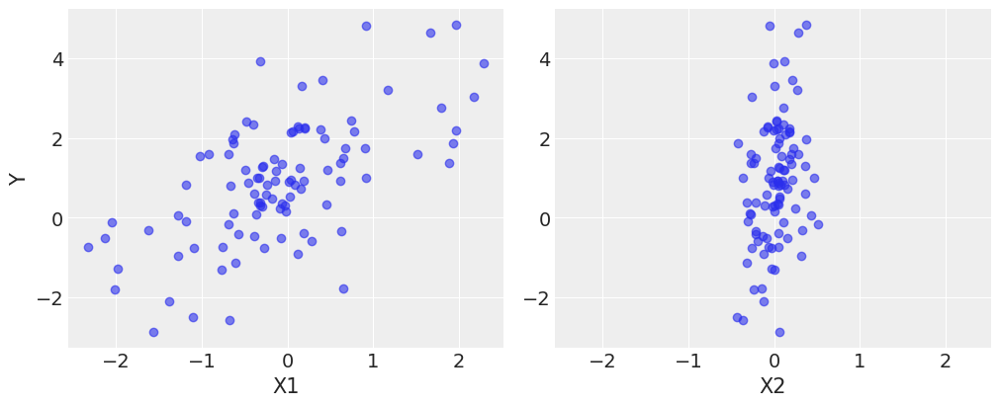

In [4]:
fig, ax = plt.subplots(nrows=1, ncols=2, sharex=True, figsize=(10,4))
ax[0].scatter(X1, Y, alpha=0.6)
ax[1].scatter(X2, Y, alpha=0.6)
ax[0].set_ylabel("Y")
ax[0].set_xlabel("X1")
ax[1].set_xlabel("X2")
plt.show()

In [5]:
import pymc3 as pm 
print("PyMC3 v{0}".format(pm.__version__))

PyMC3 v3.9.0


In [10]:
with pm.Model() as basic_model:
    # priors for unknown model params
    alpha = pm.Normal("alpha", mu=0, sigma=10)
    beta = pm.Normal("beta", mu=0, sigma=10, shape=2)
    sigma = pm.HalfNormal("sigma", sigma=1)
    # mu=pm.Deterministic("mu",alpha+beta[0]*X1 + beta[1]*X2) # Deterministic RV (tracked)
    mu=alpha+beta[0]*X1 + beta[1]*X2 # Deterministic RV (untracked)
    # it's better to not track it since we get one for each value of X1, X2

    # Likelihood
    y_obs = pm.Normal("y_obs", mu=mu, sigma=sigma, observed=Y) # Observed Stochastic variable

In [11]:
basic_model

In [12]:
map_estimate = pm.find_MAP(model=basic_model) # simply find the maximum of the posterior
print("map_estimate: {}".format(map_estimate))

Of course, this only finds (approximately) the maximum of the posterior and doesn't return the entire posterior. Preferable is to perform MCMC sampling.

`PyMC3` has adaptive Metropolis-Hastings, but usually relies on `NUTS`.

In [13]:
with basic_model:
    trace = pm.sample(draws=500, return_inferencedata=False)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [sigma, beta, alpha]


Sampling 2 chains for 1_000 tune and 500 draw iterations (2_000 + 1_000 draws total) took 16 seconds.


In [14]:
type(trace)

pymc3.backends.base.MultiTrace

Using the `return_inferencedata` option returns an `arviz` object to be used for analyzing the inference we just performed.

In [17]:
with basic_model:
    step = pm.Slice() # alternate MCMC step

    trace = pm.sample(5000, step=step, return_inferencedata=True) 

Multiprocess sampling (2 chains in 2 jobs)
CompoundStep
>Slice: [sigma]
>Slice: [beta]
>Slice: [alpha]


Sampling 2 chains for 1_000 tune and 5_000 draw iterations (2_000 + 10_000 draws total) took 22 seconds.


In [18]:
type(trace)

arviz.data.inference_data.InferenceData

These objects have members such as 
* posterior
* posterior_predictive
* log_likelihood
* sample_stats
* prior 
* prior_predictive
* observed_data


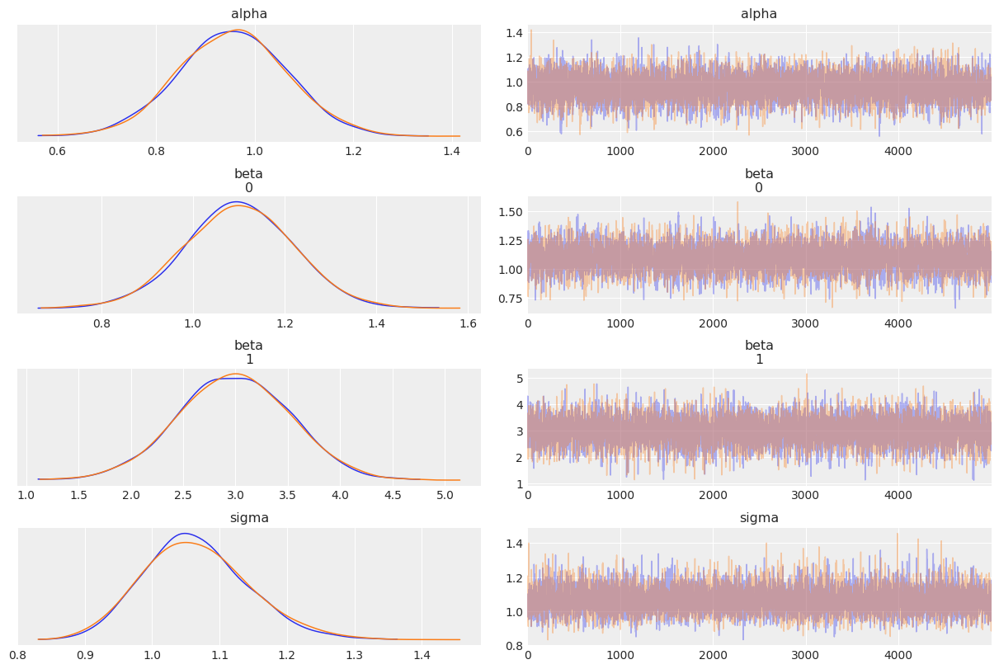

In [22]:
az.plot_trace(trace);

In [26]:
az.summary(trace, round_to=2) # view some posterior statistics

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
alpha,0.96,0.11,0.75,1.16,0.00,0.0,9813.79,9781.97,9815.29,6783.11,1.0
beta[0],1.10,0.12,0.89,1.33,0.00,0.0,8841.92,8797.67,8856.43,7109.65,1.0
beta[1],2.99,0.53,1.95,3.95,0.01,0.0,7878.01,7765.26,7879.09,6515.70,1.0
sigma,1.07,0.08,0.92,1.21,0.00,0.0,8651.16,8475.93,8901.39,6633.66,1.0


# Worked example

$$ \nu \sim \exp\left(0.1\right) $$
$$ \sigma \sim \exp\left(50\right) $$
$$ s_i \sim \mathcal{N}\left(s_{i-1}, \sigma^2\right) $$
$$ \log \left(r_i\right) \sim t\left(\nu, 0, \exp\left(-2s_i\right)\right) $$

Here, the daily return series is $r$, governed by a Student-t distribution. The degrees of freedom are unknown, and given an exponential prior. The scale parameter is governed by the variable $s$ which represents a latent process. Each $s_i$ is an individual "daily log-volatility" in the "latent log-volatility process."

In [27]:
import pandas as pd 

returns = pd.read_csv( 
    pm.get_data("SP500.csv"), parse_dates=True, index_col=0, usecols=["Date","change"]
)
len(returns)

2906

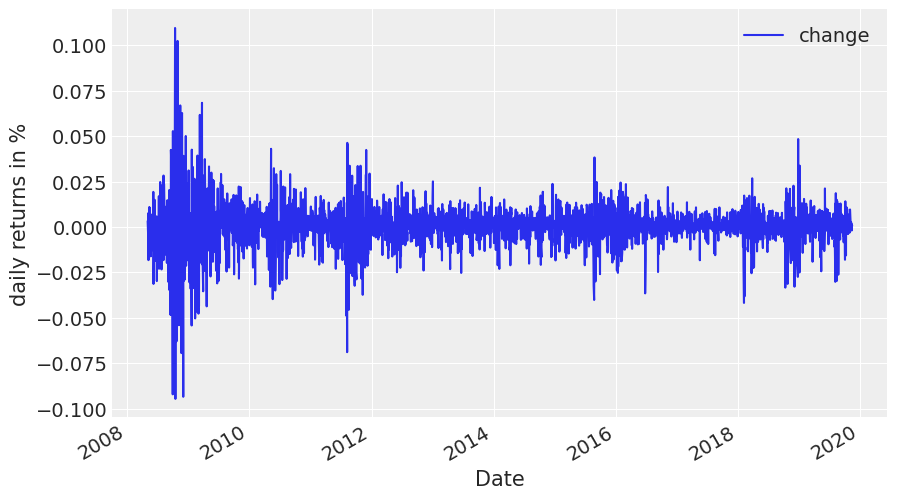

In [29]:
returns.plot(figsize=(10,6))
plt.ylabel("daily returns in %");

In [30]:
with pm.Model() as sp500_model:
    change_returns = pm.Data(
        "returns", returns["change"], dims="date", export_index_as_coords=True
    ) # Data container: we can specify the var names instead of specifying their shapes. Makes it easier
    # the model can infer coords of RVs more easily. 

    nu = pm.Exponential("nu", 0.1, testval=5.0) # specifying initialization
    sigma = pm.Exponential("sigma", 2.0, testval=0.1)

    # infer the shape based on the Data container above
    s = pm.GaussianRandomWalk("s", sigma=sigma, dims="date")
    # s = pm.GaussianRandomWalk("s", sigma=sigma, shape=len(returns))

    volatility_process = pm.Deterministic(
        "volatility_process", pm.math.exp(-2 * s) ** 0.5, dims="date"
    ) # this is the exponential in the dist for r

    r = pm.StudentT(
        "r", nu=nu, sigma=volatility_process, observed=change_returns, dims="date"
    )

In [31]:
sp500_model.RV_dims

{'returns': ('date',),
 's': ('date',),
 'volatility_process': ('date',),
 'r': ('date',)}

In [32]:
sp500_model.coords

{'date': DatetimeIndex(['2008-05-02', '2008-05-05', '2008-05-06', '2008-05-07',
                '2008-05-08', '2008-05-09', '2008-05-12', '2008-05-13',
                '2008-05-14', '2008-05-15',
                ...
                '2019-11-01', '2019-11-04', '2019-11-05', '2019-11-06',
                '2019-11-07', '2019-11-08', '2019-11-11', '2019-11-12',
                '2019-11-13', '2019-11-14'],
               dtype='datetime64[ns]', name='Date', length=2906, freq=None)}

In [33]:
with sp500_model:
    trace = pm.sample(2000, init="adapt_diag", return_inferencedata=False) # false is default

Auto-assigning NUTS sampler...
Initializing NUTS using adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [s, sigma, nu]


Sampling 2 chains for 1_000 tune and 2_000 draw iterations (2_000 + 4_000 draws total) took 640 seconds.
The estimated number of effective samples is smaller than 200 for some parameters.


array([[<AxesSubplot:title={'center':'nu'}>,
        <AxesSubplot:title={'center':'nu'}>],
       [<AxesSubplot:title={'center':'sigma'}>,
        <AxesSubplot:title={'center':'sigma'}>]], dtype=object)

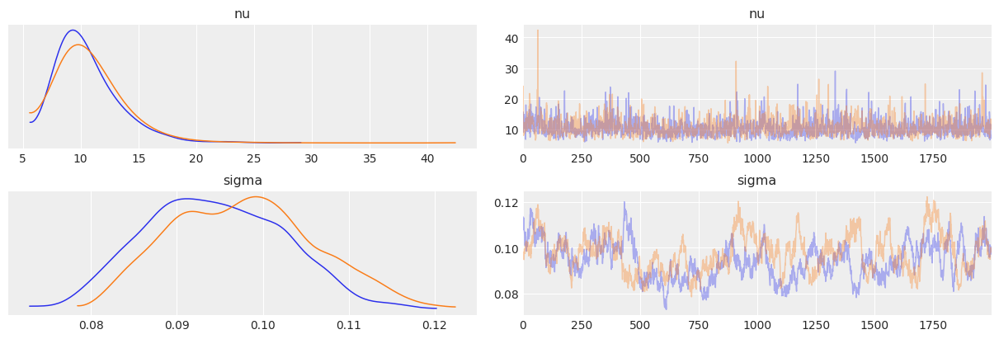

In [34]:
az.plot_trace(trace, var_names=["nu", "sigma"]) # works with MultiTrace too apparently?

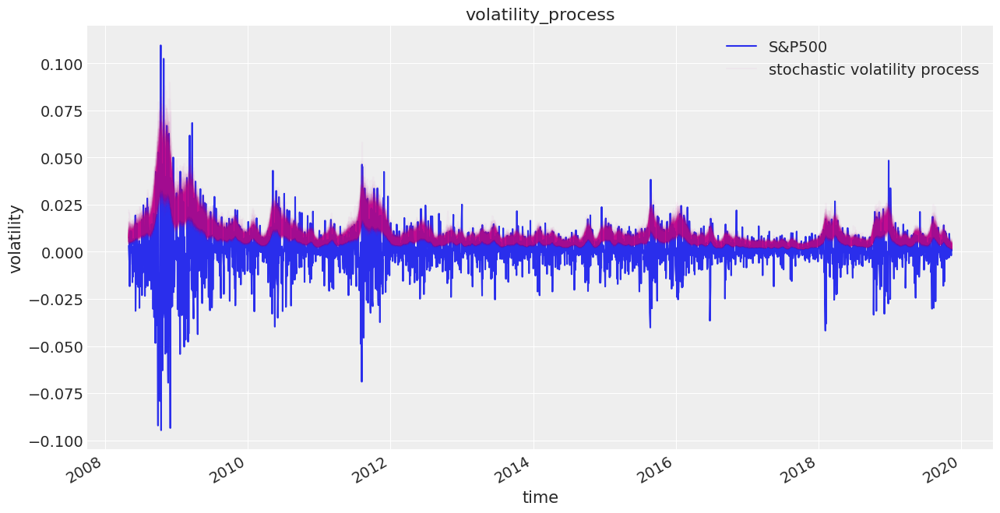

In [38]:
fig, ax = plt.subplots(figsize = (15,8))
returns.plot(ax=ax)
ax.plot(returns.index, 1/np.exp(trace["s",::10].T), "C3", alpha=0.03)
ax.set(title="volatility_process", xlabel="time", ylabel="volatility")
ax.legend(["S&P500", "stochastic volatility process"], loc="upper right")
plt.show()

# Example 2

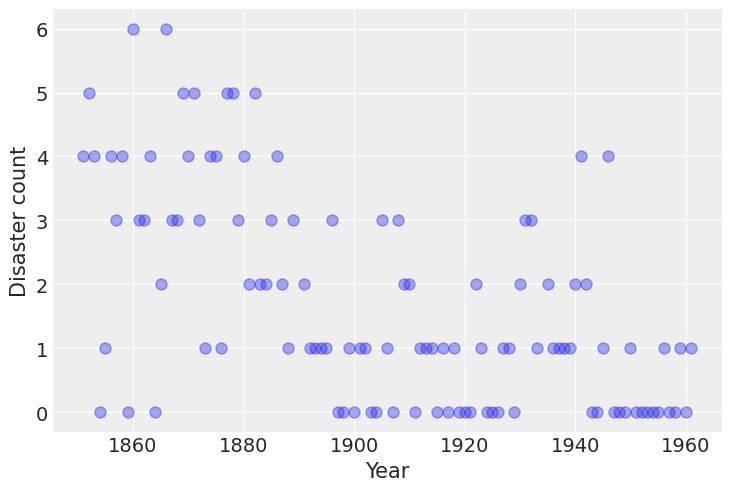

In [2]:
import pandas as pd

disaster_data = pd.Series(
    [4, 5, 4, 0, 1, 4, 3, 4, 0, 6, 3, 3, 4, 0, 2, 6,
    3, 3, 5, 4, 5, 3, 1, 4, 4, 1, 5, 5, 3, 4, 2, 5,
    2, 2, 3, 4, 2, 1, 3, np.nan, 2, 1, 1, 1, 1, 3, 0, 0,
    1, 0, 1, 1, 0, 0, 3, 1, 0, 3, 2, 2, 0, 1, 1, 1,
    0, 1, 0, 1, 0, 0, 0, 2, 1, 0, 0, 0, 1, 1, 0, 2,
    3, 3, 1, np.nan, 2, 1, 1, 1, 1, 2, 4, 2, 0, 0, 1, 4,
    0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1]
)
years = np.arange(1851, 1962)

plt.plot(years, disaster_data, "o", markersize=8, alpha=0.4)
plt.ylabel("Disaster count")
plt.xlabel("Year");

This is the number of disasters which occured in every year. It looks like there may be a trend. In particular, we hypothesize that there may have been a change in safety regulations which led to a change in behavior. This is a change-point model.

Assume the occurences in this time series follow a Poisson process, where the rate parameter changes over time.
$$  D_t  \sim  \text{Pois}\left(r_t\right), \; \; r_t = \left\{ \begin{array}{rr} e, & \text{if}\; t\leq s \\ l, & \text{if}\; t>s \end{array} \right. $$
 $$ s   \sim \text{Unif}\left(t_l, t_h\right)$$
 $$ e \sim \exp \left(1\right) $$
 $$ l \sim \exp \left(1\right) $$

In this model, $D_t$ is the number of disasters at time $t$; $r_t$ is the rate parameter used at time $t$; $s$ is the time change-point; and $e$ and $l$ are the values of the rate parameter before and after the change point, respectively.

In [4]:
with pm.Model() as disaster_model:

    s = pm.DiscreteUniform("s", lower=years.min(), upper=years.max(), testval=1900)

    e = pm.Exponential("e", lam=1)
    l = pm.Exponential("l", lam=1)

    # rt = pm.Deterministic("rt", 
    #     pm.math.switch( s >= years, e, l)
    # )
    rt = pm.math.switch( s>= years, e, l)

    Dt = pm.Poisson("Dt", mu=rt, observed=disaster_data)

In [4]:
with disaster_model:
    trace = pm.sample(4000, return_inferencedata=False)

NameError: name 'disaster_model' is not defined